<a href="https://colab.research.google.com/github/MohimenMG/maritime-density-analysis/blob/main/EU_Vessel_Density.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import zipfile
import requests
from io import BytesIO
import warnings
warnings.filterwarnings('ignore')



# Download the ZIP file into memory
url = "https://ows.emodnet-humanactivities.eu/geonetwork/srv/api/records/0f2f3ff1-30ef-49e1-96e7-8ca78d58a07c/attachments/EMODnet_HA_Vessel_Density_all_2017-2023.zip"

try:
    print("Downloading ZIP file...")
    response = requests.get(url, stream=True, timeout=60)
    response.raise_for_status()
    zip_data = BytesIO(response.content)

    # Open ZIP and list contents
    with zipfile.ZipFile(zip_data) as zf:
        all_files = zf.namelist()
        print(f"\n✅ ZIP loaded successfully — total files: {len(all_files)}")
        print("\n🔍 All files:")
        print("\n".join(all_files))

except requests.exceptions.RequestException as e:
    print("❌ Download failed:", e)


✅ ZIP loaded successfully — total files: 86

🔍 First 20 files:
EMODnet_HA_Vessel_Density_all_2017-2023/
EMODnet_HA_Vessel_Density_all_2017-2023/EMODnet_HA_Vessel_DensityMap_20240304_MD.xml
EMODnet_HA_Vessel_Density_all_2017-2023/vesseldensity_all_20170101.tif
EMODnet_HA_Vessel_Density_all_2017-2023/vesseldensity_all_20170201.tif
EMODnet_HA_Vessel_Density_all_2017-2023/vesseldensity_all_20170301.tif
EMODnet_HA_Vessel_Density_all_2017-2023/vesseldensity_all_20170401.tif
EMODnet_HA_Vessel_Density_all_2017-2023/vesseldensity_all_20170501.tif
EMODnet_HA_Vessel_Density_all_2017-2023/vesseldensity_all_20170601.tif
EMODnet_HA_Vessel_Density_all_2017-2023/vesseldensity_all_20170701.tif
EMODnet_HA_Vessel_Density_all_2017-2023/vesseldensity_all_20170801.tif
EMODnet_HA_Vessel_Density_all_2017-2023/vesseldensity_all_20170901.tif
EMODnet_HA_Vessel_Density_all_2017-2023/vesseldensity_all_20171001.tif
EMODnet_HA_Vessel_Density_all_2017-2023/vesseldensity_all_20171101.tif
EMODnet_HA_Vessel_Density_all

In [19]:
# Example: Extract January 2023 (adjust as needed)
tif_to_extract = "EMODnet_HA_Vessel_Density_all_2017-2023/vesseldensity_all_20230101.tif"

with zipfile.ZipFile(zip_data) as zf:
    zf.extract(tif_to_extract, path="/content")

extracted_path = f"/content/{tif_to_extract}"
print(f"✅ Extracted to: {extracted_path}")

✅ Extracted to: /content/EMODnet_HA_Vessel_Density_all_2017-2023/vesseldensity_all_20230101.tif


In [20]:
!pip install rasterio

In [21]:
import rasterio
with rasterio.open(extracted_path) as src:
    print("Shape:", src.shape)
    print("Data type:", src.dtypes[0])
    print("Min value:", src.read(1).min())
    print("Max value:", src.read(1).max())

Shape: (6431, 7508)
Data type: float32
Min value: -3.4028235e+38
Max value: 60982.55


In [22]:
import numpy as np
import pandas as pd

with rasterio.open(extracted_path) as src:
    band = src.read(1, masked=True)  # This returns a masked array

# Only keep valid (unmasked) values
rows, cols = np.where(~band.mask)

# Convert to lon/lat and build the DataFrame
xs, ys = rasterio.transform.xy(src.transform, rows, cols)
values = band[rows, cols]

df = pd.DataFrame({
    "longitude": xs,
    "latitude": ys,
    "density": values
})

print("Valid (unmasked) pixels:", len(df))
print("Min density:", df["density"].min())
print("Max density:", df["density"].max())
print(df.head())

Valid (unmasked) pixels: 20969020
Min density: 0.0
Max density: 60982.55078125
   longitude   latitude  density
0  4903500.0  7034500.0      0.0
1  4904500.0  7034500.0      0.0
2  4905500.0  7034500.0      0.0
3  4906500.0  7034500.0      0.0
4  4893500.0  7033500.0      0.0


In [23]:
! pip install pyproj

In [24]:
import pyproj

with rasterio.open(extracted_path) as src:
    transformer = pyproj.Transformer.from_crs(src.crs, "EPSG:4326", always_xy=True)
    df["longitude"], df["latitude"] = transformer.transform(df["longitude"].values, df["latitude"].values)

In [25]:
red_sea_df = df[
    (df.longitude >= 32.0) & (df.longitude <= 44.0) &
    (df.latitude >= 12.0) & (df.latitude <= 30.0)
]

hormuz_df = df[
    (df.longitude >= 55.0) & (df.longitude <= 60.0) &
    (df.latitude >= 24.0) & (df.latitude <= 27.0)
]

hormuz_df = hormuz_df[hormuz_df["density"] > 0]

df[(df.density > 0)]

,longitude,latitude,density
323586,9.709190,84.059291,0.081667
550742,67.400694,77.429334,0.131665
552412,67.365761,77.424056,0.131665
554087,67.306403,77.425624,0.106822
554088,67.330857,77.418773,0.024843
...,...,...,...
20968975,-14.982750,24.691767,0.151236
20968976,-14.973365,24.694631,0.099793
20968987,-14.999181,24.677243,0.078119
20968988,-14.989798,24.680109,0.162073


In [26]:
!wget -q https://naciscdn.org/naturalearth/110m/cultural/ne_110m_admin_0_countries.zip -O world_countries.zip
!unzip -o world_countries.zip -d world_countries

Archive:  world_countries.zip
  inflating: world_countries/ne_110m_admin_0_countries.README.html  
 extracting: world_countries/ne_110m_admin_0_countries.VERSION.txt  
 extracting: world_countries/ne_110m_admin_0_countries.cpg  
  inflating: world_countries/ne_110m_admin_0_countries.dbf  
  inflating: world_countries/ne_110m_admin_0_countries.prj  
  inflating: world_countries/ne_110m_admin_0_countries.shp  
  inflating: world_countries/ne_110m_admin_0_countries.shx  


In [27]:
import os

# List files in the current working directory
print(os.listdir("/content"))

# Or in a subdirectory (like the one you unzipped into)
print(os.listdir("/content/world_countries"))

['.config', 'EMODnet_HA_Vessel_Density_all_2017-2023', 'world_countries.zip', 'world_countries', 'sample_data']
['ne_110m_admin_0_countries.README.html', 'ne_110m_admin_0_countries.prj', 'ne_110m_admin_0_countries.VERSION.txt', 'ne_110m_admin_0_countries.shx', 'ne_110m_admin_0_countries.shp', 'ne_110m_admin_0_countries.cpg', 'ne_110m_admin_0_countries.dbf']


In [28]:
import geopandas as gpd

# Correct shapefile path
shapefile_path = "/content/world_countries/ne_110m_admin_0_countries.shp"

# Load the world basemap
world = gpd.read_file(shapefile_path)

# Confirm it loaded
print(f"✅ Loaded {len(world)} countries.")

✅ Loaded 177 countries.


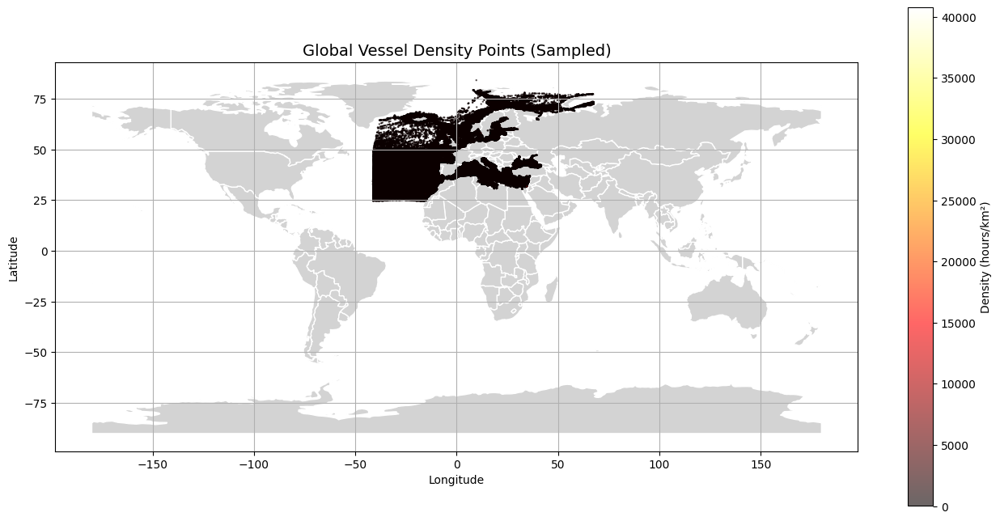

In [29]:
import matplotlib.pyplot as plt

# Sample for speed
sample_df = df[df["density"] > 0].sample(min(200_000, len(df[df["density"] > 0])))

# Create plot
fig, ax = plt.subplots(figsize=(16, 8))

# Plot world map
world.plot(ax=ax, color="lightgrey", edgecolor="white", zorder=0)

# Plot vessel density points
scatter = ax.scatter(
    sample_df["longitude"],
    sample_df["latitude"],
    c=sample_df["density"],
    cmap="hot",
    s=0.5,
    alpha=0.6,
    zorder=1
)

plt.title("Global Vessel Density Points (Sampled)", fontsize=14)
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.colorbar(scatter, label="Density (hours/km²)")
plt.grid(True)
plt.show()

In [30]:
print(df[["longitude", "latitude"]].describe())


          longitude      latitude
count  2.096902e+07  2.096902e+07
mean  -5.827070e+00  5.061523e+01
std    2.564298e+01  1.616957e+01
min   -4.137127e+01  2.454388e+01
25%   -2.611317e+01  3.671400e+01
50%   -1.251258e+01  4.761194e+01
75%    1.165958e+01  6.381936e+01
max    6.866327e+01  8.631103e+01


In [31]:
!pip install plotly

In [32]:
import plotly.express as px

# Optional: Filter or sample data for speed
sample_df = df[df["density"] > 0].sample(n=min(200_000, len(df[df["density"] > 0])), random_state=1)

# Plot using scatter_mapbox
fig = px.density_mapbox(
    sample_df,
    lat="latitude",
    lon="longitude",
    z="density",  # this controls heat intensity
    radius=4,  # adjust for smoother blobs
    center={"lat": 25, "lon": 30},  # center the map, e.g., Middle East
    zoom=1.3,
    mapbox_style="carto-positron",  # try "open-street-map" or "stamen-terrain"
    color_continuous_scale="Turbo",  # or "Hot", "Viridis", "Inferno"
    title="Global Vessel Density Map (Sampled)"
)

fig.update_layout(height=700, margin={"r":0,"t":40,"l":0,"b":0})
fig.show()

In [ ]:
print(df["density"].min(), df["density"].max())


0.0 60982.55078125


In [39]:
import plotly.express as px
import numpy as np

# Create log-transformed column for coloring
df["density_log"] = np.log10(df["density"] + 1)

# Sample for speed
sample_df = df[df["density"] > 0].sample(min(200_000, len(df[df["density"] > 0])))

# Plotly Mapbox with hover showing both log and raw values
fig = px.scatter_mapbox(
    sample_df,
    lat="latitude",
    lon="longitude",
    color="density_log",
    color_continuous_scale="Turbo",
    size_max=3,
    zoom=2,
    height=700,
    opacity=0.6,
    title="Vessel Density — Log Color with Raw Hover Value",
    hover_data={
        "density": True,        # show original value
        "density_log": True,    # show log value
        "latitude": False,      # optionally hide lat/lon in tooltip
        "longitude": False
    }
)

# Use Mapbox without token
fig.update_layout(mapbox_style="carto-positron")

# Customize colorbar label
fig.update_coloraxes(colorbar_title="log₁₀(Density + 1)")

fig.show()